<span style="font-size: 20pt;"><span style="font-weight: bold;">Chapter 14.</span>Introducing geographic information systems: Data across space and place</span>

Last update: 12 January 2024

Thank you for checking out the code for: 

> Hogan, Bernie (2023) _From Social Science to Data Science_. London, UK: Sage Publications. 

This notebook contains the code from the book, along with the headers and additional author notes that are not in the book as a way to help navigate the code. You can run this notebook in a browser by clicking the buttons below. 
    
The version that is uploaded to GitHub should have all the results pasted, but the best way to follow along is to clear all outputs and then start afresh. To do this in Jupyter go the menu and select "Kernel -> Restart Kernel and Clear all Outputs...". To do this on Google Colab go to the menu and select "Edit -> Clear all outputs".
    
The most up-to-date version of this code can be found at https://www.github.com/berniehogan/fsstds 

Additional resources and teaching materials can be found on Sage's forthcoming website for this book. 

All code for the book and derivative code on the book's repository is released open source under the  MIT license. 

> **Please note** Unlike other chapters, running this one on Colab or Binder could be very challenging depending on your installation. The video tutorial for this chapter will assume you are running this locally and will even go through the installation process (which can be very tricky). You can see some advice below on installation. You are also encouraged to check out the [supplementary chapter on Virtual Environments](https://github.com/berniehogan/fsstds/blob/main/supplemental_notebooks/Ch.Sup.VirtualEnvironmentsAndInstalls.ipynb).

[![Binder](https://mybinder.org/badge.svg)](https://mybinder.org/v2/gh/berniehogan/fsstds/main?filepath=chapters%2FCh.14.Geography.ipynb)[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/berniehogan/fsstds/blob/main/chapters/Ch.14.Geography.ipynb)

<span style="font-size: 20pt;">📺 YouTube Video lecture for this chapter 📺</span>

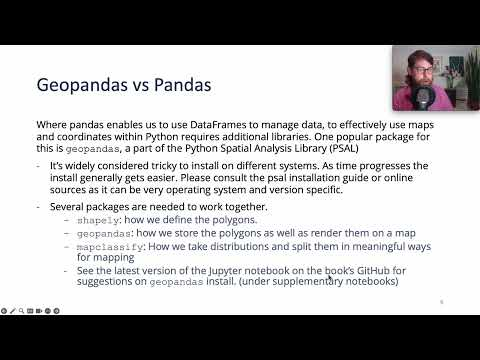

In [4]:
from IPython.display import YouTubeVideo

YouTubeVideo('NTPgdTX7l6w')

# Introduction: From Space to Place

# Kinds of spatial data 

## From a sphere to a rectangle.

## Mapping places on to spaces 

### Installing GeoPandas 

Installing the Python Spatial Analysis Library and geopandas can generally be a rather tricky affair. I would encourage you to seek out help online or in the issue tracker for this book. However, here is the walkthrough that I will be using in this tutorial: 

1. In the terminal, **create a virtual environment** for this chapter _in conda_. From your fsstds directory or your home directory type the following:
  - `%` means the terminal prompt. Only copy the code _after_ the `%` symbol. 
  - `% conda create -n geoenv python=3.11`
  - `% conda install -c anaconda ipykernel` (unused for now)
  - Notice that we are installing with Python 3.11. We can be confident this version will work with PySAL, however, if you leave that blank, then it will install the most recent version (3.12) which still has some compatibility issues. 

3. **Activate this environment**. You will know it is activated because it will say so on the terminal like the following:
    
  - `% conda activate geoenv`

4. Once in that environment you will need to **install both pysal and jupyter lab**. I would recommend installing Jupyter Lab first.

  - `% conda install -c conda-forge jupyterlab`
  - `% pip install pysal`
  - While there is also a way to install `pysal` through conda, lately I have found that pip works better. 

5. Then **run jupyter lab**. It will be a new instance of Jupyter Lab and will not have your other installed packages available.

  - `% jupyter lab`

Why do this in a virtual environment? A virtual environment will not interfere with your other Python install. As you get deeper into data science, you will find that you might have to 'freeze' a version of Python so that modules correctly install given that these modules are updated at inconsistent schedules. This way, if the install does not work then you can remove the virtual environment and start again without having upgrade issues in your main Python. 

Broadly speaking it is a good idea to use virtual environments (either through conda or python) for a given analysis or production task. 

In [1]:
# Lazy route that may or may not work
# Use at your own risk if you are not in a virtual environment: 
# !pip install pysal

In [2]:
import libpysal
import geopandas 
import matplotlib.pyplot as plt 
%config InlineBackend.figure_format = 'svg'

In [3]:
geopandas.__version__

'0.14.0'

In [4]:
world = geopandas.read_file(geopandas.datasets.\
                            get_path('naturalearth_lowres'))

print(world.columns)

/var/folders/nz/ktq58_012jl27qg9sslt9lwm0000gp/T/ipykernel_23727/2830827981.py:2: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  get_path('naturalearth_lowres'))


Index(['pop_est', 'continent', 'name', 'iso_a3', 'gdp_md_est', 'geometry'], dtype='object')


For many recent versions of geopandas you may recieve a warning that`FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0.` or worse, if you have installed Geopandas 1.0+ then it may just give an error. In which case, you can indeed download the shapefile for the earth from the following URL: 

https://www.naturalearthdata.com/downloads/110m-cultural-vectors/

Select "Admin - 0 countries". It will download a `.zip` file. When unzipped that file will produce a folder called `ne_110m_admin_0_countries`. Place that folder in your `data` folder for this book. Then you can instead get to the same place with the following code (hopefully): 

~~~ python
from pathlib import Path 
data_dir = Path.cwd().parent / "data" / "ne_110m_admin_0_countries"
world = geopandas.read_file(data_dir / "ne_110m_admin_0_countries.shp")
~~~

That being said, it will not have all the columns. At that point it would be useful to work with the new preferred approach which will be to call datasets directly from `libpysal.available`. However, since it will not be backwards compatible. Even this will still cause some trouble with the examples, so please stay tuned for a reworked version of this chapter on the GitHub archive to coincide with Geopandas 1.0. 

In [5]:
# from pathlib import Path 
# data_dir = Path.cwd().parent / "data" / "ne_110m_admin_0_countries"
# world = geopandas.read_file(data_dir / "ne_110m_admin_0_countries.shp")

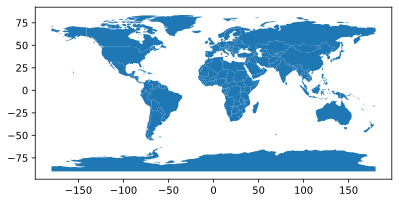

In [6]:
world.plot() 
plt.show()

# Pretty much all the code after this that queries by country etc... 
# will not work with the alternative approach loading the dataset from ne_110m_admin etc... 
# However, you can view the code and skip to the section below where we download 
# our own shape files and merge in data (3.1 Loading your own maps) which should still work
#
# The shapefile was graciously provided by GADM 
# The data is a static snapshot of the OxCOVID database hosted by the Oxford Internet Institute.

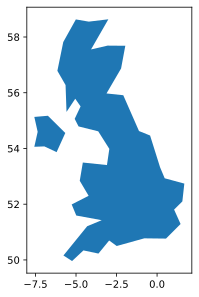

In [7]:
world[world['iso_a3'] == "GBR"].plot()
plt.show()

## GeoPandas GeoDataFrames discussed

In [8]:
world[["name","iso_a3","gdp_md_est","geometry"]].head()

,name,iso_a3,gdp_md_est,geometry
0,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


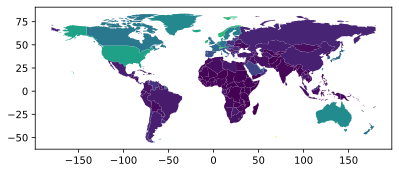

In [9]:
world['gdp_per_cap'] = world['gdp_md_est'] / world['pop_est']

world_na = world[world.name!="Antarctica"]

world_na.plot(column='gdp_per_cap')

plt.show()

In [10]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

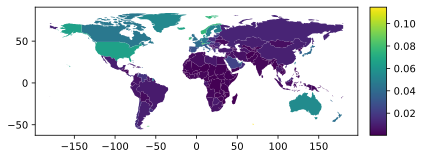

In [11]:
fig, ax = plt.subplots()

divider = make_axes_locatable(ax)

cax = divider.append_axes("right", size="5%", pad=0.1)

world_na.plot(column='gdp_per_cap', ax=ax, legend=True, cax=cax); 
plt.show()

In [12]:
world_na.sort_values("gdp_per_cap")\
    [["name","iso_a3","pop_est","gdp_md_est","gdp_per_cap"]].tail()

,name,iso_a3,pop_est,gdp_md_est,gdp_per_cap
133,Ireland,IRL,4941444.0,388698,0.078661
127,Switzerland,CHE,8574832.0,703082,0.081994
20,Falkland Is.,FLK,3398.0,282,0.082990
23,Fr. S. Antarctic Lands,ATF,140.0,16,0.114286
128,Luxembourg,LUX,619896.0,71104,0.114703


## Splitting the data into intervals using `mapclassify` 

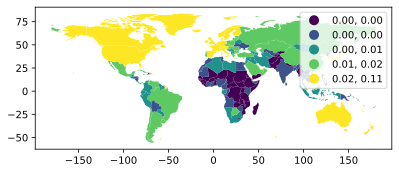

In [13]:
world_na.plot(column='gdp_per_cap', 
              scheme='quantiles',
              # cmap='YlGn',
              legend =True);

plt.show()

In [14]:
import mapclassify as mc 

print(mc.Quantiles(world["gdp_per_cap"], k=5), sep="\n\n")

Quantiles

  Interval     Count
--------------------
[0.00, 0.00] |    36
(0.00, 0.00] |    35
(0.00, 0.01] |    35
(0.01, 0.03] |    35
(0.03, 0.20] |    36


## Plotting points

In [15]:
cities = geopandas.read_file(
    geopandas.datasets.get_path('naturalearth_cities'))

cities.head()

/var/folders/nz/ktq58_012jl27qg9sslt9lwm0000gp/T/ipykernel_23727/3808061744.py:2: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_cities' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  geopandas.datasets.get_path('naturalearth_cities'))


,name,geometry
0,Vatican City,POINT (12.45339 41.90328)
1,San Marino,POINT (12.44177 43.93610)
2,Vaduz,POINT (9.51667 47.13372)
3,Lobamba,POINT (31.20000 -26.46667)
4,Luxembourg,POINT (6.13000 49.61166)


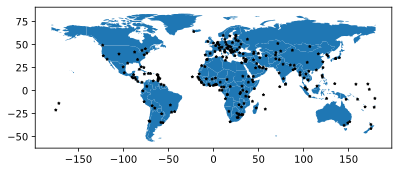

In [16]:
ax = world_na.plot() 

cities.plot(marker = "*", color = "black", markersize = 5, ax=ax)

plt.show()

# Creating your own GeoDataFrame

In [17]:
import pandas as pd 

In [18]:
landmarks = pd.DataFrame({"name":["Greenville"],
             "lat":[33.398],"long":[-91.048]})

In [19]:
landmarks

,name,lat,long
0,Greenville,33.398,-91.048


In [21]:
gdf = geopandas.GeoDataFrame(landmarks, 
        geometry=geopandas.points_from_xy(landmarks.long,landmarks.lat))

display(gdf)

,name,lat,long,geometry
0,Greenville,33.398,-91.048,POINT (-91.04800 33.39800)


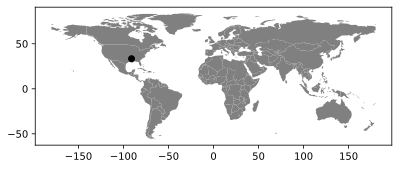

In [22]:
ax1 = world_na.plot(color="grey") 

gdf.plot(color="black", ax=ax1)

plt.show()

## Loading your own maps

In [23]:
from pathlib import Path
import pandas as pd 
import matplotlib.pyplot as plt
import geopandas
import mapclassify as mc
%config InlineBackend.figure_format = 'svg'

In [24]:
data_dir = Path.cwd().parent / "data" 
gbshp = geopandas.read_file(data_dir / "gadm36_GBR_shp" / "gadm36_GBR_1.shp")
gbshp.plot()

plt.show()

In [25]:
gbshp = geopandas.read_file(data_dir / "gadm36_GBR_shp" / "gadm36_GBR_3.shp")
gbshp.plot()

<Axes: >

In [26]:
print(gbshp.columns)

Index(['GID_0', 'NAME_0', 'GID_1', 'NAME_1', 'NL_NAME_1', 'GID_2', 'NAME_2',
       'NL_NAME_2', 'GID_3', 'NAME_3', 'VARNAME_3', 'NL_NAME_3', 'TYPE_3',
       'ENGTYPE_3', 'CC_3', 'HASC_3', 'geometry'],
      dtype='object')


In [27]:
gbshp[["NAME_1","GID_3","NAME_3","geometry"]].sample(5,random_state=7)

,NAME_1,GID_3,NAME_3,geometry
220,England,GBR.1.66.1_1,Nottingham,"POLYGON ((-1.21835 52.90842, -1.19623 52.92150..."
295,England,GBR.1.103.1_1,Torbay,"POLYGON ((-3.57106 50.48154, -3.56102 50.49372..."
391,Wales,GBR.4.8.1_1,Conwy,"POLYGON ((-3.51270 53.31681, -3.51362 53.30691..."
357,Scotland,GBR.3.6.1_1,Dumfries and Galloway,"MULTIPOLYGON (((-3.97972 54.76820, -3.98583 54..."
384,Wales,GBR.4.1.1_1,Anglesey,"MULTIPOLYGON (((-4.48695 53.17625, -4.48750 53..."


## Linking maps to other data sources 

In [28]:
covid_df = pd.read_csv(data_dir / "covid19db-epidemiology-GBR_PHE.csv.bz2")

print(len(covid_df))
display(covid_df.loc[0])

260119


source                       GBR_PHE
date                      14-09-2021
country               United Kingdom
countrycode                      GBR
adm_area_1                   England
adm_area_2                 Hampshire
adm_area_3                   Gosport
tested                           NaN
confirmed                     6949.0
recovered                        NaN
dead                           158.0
hospitalised                     NaN
hospitalised_icu                 NaN
quarantined                      NaN
gid                 ['GBR.1.38.5_1']
Name: 0, dtype: object

In [29]:
type(covid_df.loc[0]["gid"])

str

In [30]:
cdf = covid_df[covid_df.date=="14-09-2021"].copy()
print(len(cdf),len(gbshp[gbshp['NAME_1'] == "England"]))

315 326


In [31]:
import ast

In [32]:
try: 
    cdf.gid = cdf.gid.map(ast.literal_eval)
    print(len(cdf.gid.sum()))
except ValueError: 
    print("You can only convert the data once")

326


In [33]:
cdf.gid.map(lambda x: len(x)).value_counts()

gid
1    308
2      5
3      1
5      1
Name: count, dtype: int64

In [34]:
cdf["lengids"]= cdf.gid.map(len)
cdf["ndead"] = cdf["dead"] / cdf["lengids"]
cdf["nconfirmed"] = cdf["confirmed"] / cdf["lengids"]

cdf_ex = cdf[["gid","ndead","nconfirmed"]].explode("gid")

# Some data integrity checks 
print(len(gbshp[gbshp["NAME_1"] == "England"]) == len(cdf_ex))
print(cdf["confirmed"].sum() == cdf_ex["nconfirmed"].sum())

True
True


In [35]:
cdf_ex["cfr"] = cdf_ex['ndead'] / cdf_ex['nconfirmed']

print(cdf_ex["cfr"].describe())

count    326.000000
mean       0.020349
std        0.005692
min        0.008807
25%        0.016426
50%        0.019581
75%        0.023528
max        0.045195
Name: cfr, dtype: float64


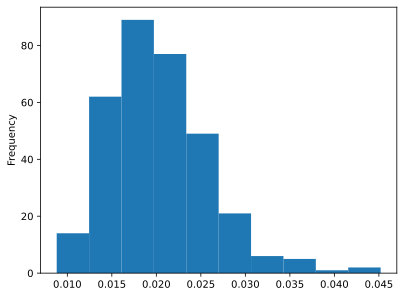

In [36]:
cdf_ex["cfr"].plot(kind="hist");
plt.show()

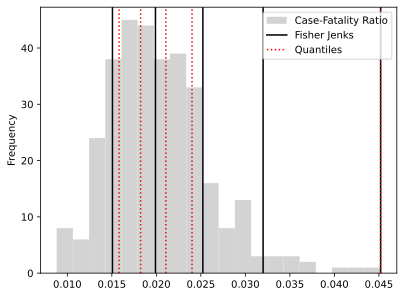

In [37]:
fig, ax = plt.subplots() 

cdf_ex["cfr"].plot(kind="hist",bins=20,
                   color="lightgrey",label="Case-Fatality Ratio") 

res_fj = mc.FisherJenks(cdf_ex.cfr)
ax.axvline(res_fj.bins[0],color="black",label="Fisher Jenks")
for i in res_fj.bins[1:]: 
    ax.axvline(i,color="black")

res_q = mc.Quantiles(cdf_ex.cfr)
ax.axvline(res_q.bins[0],linestyle=":",color="red",label="Quantiles")
for i in res_q.bins[1:]: 
    ax.axvline(i,linestyle=":", color="red")

ax.legend()

plt.show()

In [38]:
eng_covid_df = gbshp.merge(cdf_ex,
                     left_on="GID_3",right_on="gid")

In [39]:
ax = eng_covid_df.plot(column="cfr", 
         scheme="fisher_jenks", legend=True)

leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0.5, 1.5, 0.))
ax.set_axis_off()

plt.show()

# Summary

# Further topics and reading

# Extending and reflecting